# 1. Author

Name: Krishna Sameer Kummetha


In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import os, sys, re, pickle, glob
import urllib.request
import zipfile

import IPython.display as ipd
from tqdm import tqdm
import librosa

# 2. Problem formulation: 

Identify the song label (Potter or Starwars) from audio files provided which contain only whistle and hums of the respective label.

This problem is interesting for me because we have to think of ML model using only hums and whistle instead of actual song.
And the fun part is these audio data is collected by us.

# 3. Dataset pre processing

In [ ]:
sample_path = 'G:/audio/potter_star/*.wav'
files = glob.glob(sample_path)
len(files)

834

In [ ]:
for _ in range(5):
  n = np.random.randint(834)
  display(ipd.Audio(files[n]))

In [ ]:
for file in files: #audio file names
    print(file.split('\\')[-1])

S100_hum_1_Potter.wav
S100_hum_2_Potter.wav
S100_hum_3_StarWars.wav
S100_hum_4_StarWars.wav
S101_hum_1_Potter.wav
S101_hum_2_Potter.wav
S101_hum_3_StarWars.wav
S101_hum_4_StarWars.wav
S102_hum_2_Potter.wav
S102_whistle_1_Star wars.wav
S102_whistle_2_Potter.wav
S102_whistle_2_Star wars.wav
S103_hum_2_Potter.wav
S103_hum_2_StarWars.wav
S103_whistle_2_Potter.wav
S103_whistle_2_StarWars.wav
S104_Hum_1_Potter.wav
S104_Hum_2_Potter.wav
S104_Hum_3_StarWars.wav
S104_Hum_4_StarWars.wav
S105_hum_1_harry potter.wav
S105_whistle_2_starwars.wav
S106_hum_1_Potter.WAV
S106_hum_2_Potter.WAV
S106_hum_3_Starwars.WAV
S106_hum_4_Starwars.WAV
S107_hum_2_Potter.wav
S107_hum_2_Starwars.wav
S107_whistle_2_Potter.wav
S107_whistle_2_Starwars.wav
S108_hum_2_Potter.wav
S108_hum_2_StarWars.wav
S108_whistle_2_Potter.wav
S108_whistle_2_StarWars.wav
S109_hum_1_[Potter].wav
S109_hum_3_[StarWars].wav
S109_hum_4_[StarWars].wav
S109_whistle_1_[Potter].wav
S10_hum_1_Potter .wav
S10_hum_2_Potter .wav
S10_hum_3_StarWars.wav

In [ ]:
files[35] #Checking file format

'G:/audio/potter_star\\S109_hum_3_[StarWars].wav'

#### It can be observed that we have file in two format .wav and .WAV

In [ ]:
import os
path="G:/audio/potter_star/"
files=os.listdir("G:/audio/potter_star/")
pre_word, extension = os.path.splitext(files[0])
for index, file in enumerate(files):
    pre, ext = os.path.splitext(file)
    print("pre:",pre)
    print("ext:",ext)

pre: S100_hum_1_Potter
ext: .wav
pre: S100_hum_2_Potter
ext: .wav
pre: S100_hum_3_StarWars
ext: .wav
pre: S100_hum_4_StarWars
ext: .wav
pre: S101_hum_1_Potter
ext: .wav
pre: S101_hum_2_Potter
ext: .wav
pre: S101_hum_3_StarWars
ext: .wav
pre: S101_hum_4_StarWars
ext: .wav
pre: S102_hum_2_Potter
ext: .wav
pre: S102_whistle_1_Star wars
ext: .wav
pre: S102_whistle_2_Potter
ext: .wav
pre: S102_whistle_2_Star wars
ext: .wav
pre: S103_hum_2_Potter
ext: .wav
pre: S103_hum_2_StarWars
ext: .wav
pre: S103_whistle_2_Potter
ext: .wav
pre: S103_whistle_2_StarWars
ext: .wav
pre: S104_Hum_1_Potter
ext: .wav
pre: S104_Hum_2_Potter
ext: .wav
pre: S104_Hum_3_StarWars
ext: .wav
pre: S104_Hum_4_StarWars
ext: .wav
pre: S105_hum_1_harry potter
ext: .wav
pre: S105_whistle_2_starwars
ext: .wav
pre: S106_hum_1_Potter
ext: .WAV
pre: S106_hum_2_Potter
ext: .WAV
pre: S106_hum_3_Starwars
ext: .WAV
pre: S106_hum_4_Starwars
ext: .WAV
pre: S107_hum_2_Potter
ext: .wav
pre: S107_hum_2_Starwars
ext: .wav
pre: S107_whistl

ext: .wav
pre: S221_hum_2_StarWars
ext: .wav
pre: S221_whistle_2_Potter
ext: .wav
pre: S222_hum_2_Potter
ext: .wav
pre: S222_hum_2_StarWars
ext: .wav
pre: S222_whistle_2_Potter
ext: .wav
pre: S222_whistle_2_StarWars
ext: .wav
pre: S22_hum_1_Potter
ext: .wav
pre: S22_hum_2_Potter
ext: .wav
pre: S22_hum_3_StarWars
ext: .wav
pre: S22_hum_4_StarWars
ext: .wav
pre: S23_hum_1_Potter
ext: .wav
pre: S23_hum_2_Potter
ext: .wav
pre: S23_hum_3_StarWars
ext: .wav
pre: S23_hum_4_StarWars
ext: .wav
pre: S24_hum_2_Potter
ext: .wav
pre: S24_hum_2_StarWars
ext: .wav
pre: S24_whistle_2_Potter
ext: .wav
pre: S24_whistle_2_Starwars
ext: .wav
pre: S25_hum_1_Potter
ext: .wav
pre: S25_hum_2_Potter
ext: .wav
pre: S25_hum_3_StarWars
ext: .wav
pre: S25_hum_4_StarWars
ext: .wav
pre: S26_hum_1_Potter
ext: .wav
pre: S26_hum_2_Potter
ext: .wav
pre: S26_hum_3_StarWars
ext: .wav
pre: S26_hum_4_StarWars
ext: .wav
pre: S28_hum_1_Potter
ext: .wav
pre: S28_hum_2_Potter
ext: .wav
pre: S28_hum_3_StarWars
ext: .wav
pre: S28

### Code to rename all .WAV format to .wav so that we all have file in one format

In [ ]:
import os
path="G:/audio/potter_star/"
files=os.listdir("G:/audio/potter_star/")
pre_word, extension = os.path.splitext(files[0])
for index, file in enumerate(files):
    pre, ext = os.path.splitext(file)
    os.rename(os.path.join(path, file), os.path.join(path, pre + extension))

In [ ]:
import os
path="G:/audio/potter_star/"
files=os.listdir("G:/audio/potter_star/")
pre_word, extension = os.path.splitext(files[0])
for index, file in enumerate(files):
    pre, ext = os.path.splitext(file)
    print("pre:",pre)
    print("ext:",ext)

pre: S100_hum_1_Potter
ext: .wav
pre: S100_hum_2_Potter
ext: .wav
pre: S100_hum_3_StarWars
ext: .wav
pre: S100_hum_4_StarWars
ext: .wav
pre: S101_hum_1_Potter
ext: .wav
pre: S101_hum_2_Potter
ext: .wav
pre: S101_hum_3_StarWars
ext: .wav
pre: S101_hum_4_StarWars
ext: .wav
pre: S102_hum_2_Potter
ext: .wav
pre: S102_whistle_1_Star wars
ext: .wav
pre: S102_whistle_2_Potter
ext: .wav
pre: S102_whistle_2_Star wars
ext: .wav
pre: S103_hum_2_Potter
ext: .wav
pre: S103_hum_2_StarWars
ext: .wav
pre: S103_whistle_2_Potter
ext: .wav
pre: S103_whistle_2_StarWars
ext: .wav
pre: S104_Hum_1_Potter
ext: .wav
pre: S104_Hum_2_Potter
ext: .wav
pre: S104_Hum_3_StarWars
ext: .wav
pre: S104_Hum_4_StarWars
ext: .wav
pre: S105_hum_1_harry potter
ext: .wav
pre: S105_whistle_2_starwars
ext: .wav
pre: S106_hum_1_Potter
ext: .wav
pre: S106_hum_2_Potter
ext: .wav
pre: S106_hum_3_Starwars
ext: .wav
pre: S106_hum_4_Starwars
ext: .wav
pre: S107_hum_2_Potter
ext: .wav
pre: S107_hum_2_Starwars
ext: .wav
pre: S107_whistl

ext: .wav
pre: S216_hum_1_Potter
ext: .wav
pre: S216_hum_2_Potter
ext: .wav
pre: S216_hum_3_StarWars
ext: .wav
pre: S216_hum_4_StarWars
ext: .wav
pre: S217_hum_2_Potter
ext: .wav
pre: S217_hum_2_StarWars
ext: .wav
pre: S217_whistle_2_Potter
ext: .wav
pre: S217_whistle_2_StarWars
ext: .wav
pre: S218_hum_2_Potter
ext: .wav
pre: S218_hum_2_StarWars
ext: .wav
pre: S218_whistle_2_Potter
ext: .wav
pre: S218_whistle_2_StarWars
ext: .wav
pre: S219_hum_1_Potter
ext: .wav
pre: S219_hum_2_Potter
ext: .wav
pre: S219_hum_3_StarWars
ext: .wav
pre: S219_hum_4_StarWars
ext: .wav
pre: S21_hum_1_Potter
ext: .wav
pre: S21_hum_2_Potter
ext: .wav
pre: S21_hum_3_StarWars
ext: .wav
pre: S21_hum_4_StarWars
ext: .wav
pre: S221_hum_1_StartWars
ext: .wav
pre: S221_hum_2_Potter
ext: .wav
pre: S221_hum_2_StarWars
ext: .wav
pre: S221_whistle_2_Potter
ext: .wav
pre: S222_hum_2_Potter
ext: .wav
pre: S222_hum_2_StarWars
ext: .wav
pre: S222_whistle_2_Potter
ext: .wav
pre: S222_whistle_2_StarWars
ext: .wav
pre: S22_hum_

#### After changing all files in one format I have written a regex format to match the given format that is: studentno_hum_1_songname and studentno_whistle_1_songname.

In [ ]:
MLENDHW_table = [] 
wrong_title=[]
count=0
files=os.listdir("G:/audio/potter_star/")
for file in files:
    file_name = file.split('\\')[-1]
    matched = re.match("[S][0-9]{1,3}\_[a-zA-Z]{3,7}\_[0-9]\_[a-zA-Z]{1,8}.wav$", file_name)
    is_match = bool(matched)
    if is_match is False:
        print("error:",file_name)
        wrong_title.append(file_name)
        count= count + 1
print("Number of errors:",count)

error: S102_whistle_1_Star wars.wav
error: S102_whistle_2_Star wars.wav
error: S105_hum_1_harry potter.wav
error: S109_hum_1_[Potter].wav
error: S109_hum_3_[StarWars].wav
error: S109_hum_4_[StarWars].wav
error: S109_whistle_1_[Potter].wav
error: S10_hum_1_Potter .wav
error: S10_hum_2_Potter .wav
error: S114_hum_3_star wars.wav
error: S114_hum_4_star wars.wav
error: S12_hum_2_Potter .wav
error: S12_hum_4_Potter .wav
error: S130_hum_2_StarWars.wav.wav
error: S130_whistle_1_Potter.wav.wav
error: S130_whistle_1_StarWars.wav.wav
error: S130_whistle_2_Potter.wav.wav
error: S131_hum_1_[Potter].wav
error: S131_whistle_1_[Potter].wav
error: S134_hum_1_[Potter].wav
error: S134_hum_1_[StarWars].wav
error: S134_hum_2_[StarWars].wav
error: S134_whistle_1_[Potter].wav
error: S138_hum_1_Harry_Potter_Theme_Song.wav
error: S138_whistle_1_Harry_Potter_Theme_Song.wav
error: S141_hum2_Imperial_March.wav
error: S141_whistle_2_Imperial_March.wav
error: S145_hum_1_[Potter].wav
error: S145_hum_1_[StarWars].wa

#### There are total of 119 files out of 834 where it doesn't match our format

In [ ]:
#Code for formatting error files
count=0
keep=0
filter_wrong_title=[] #list to store file name which coudn't be formatted
replaced_title={} #Dictionary to keep a track which file name were changed
for sent in wrong_title:
    original_sent=sent
    keep=keep+1
    if "[" or "]" in sent: #for [] issue 
        sent=sent.replace("[","")
        sent=sent.replace("]","")
        
    if "(" or ")" in sent: #for () issue
        sent=sent.replace("(","")
        sent=sent.replace(")","")
    if sent[-5]== " ": #for space before .wav
        sent=sent.replace(" ","")
    if " " in sent: #for space between names issue
        count_space=0
        for i in range(0,len(sent)):
            if sent[i]== " ":
                count_space+= 1
        if count_space==2:
            sent=sent.replace(" ","_")
    if "Star wars" in sent: #for space between starwars
        sent=sent.replace(" ","")
    if "star wars" in sent:
        sent=sent.replace(" ","")
    if ".wav.wav" in sent: #for .wav.wav issue
        sent=sent[0:-4]
    replaced_title[original_sent]=sent
    matched = re.match("[S][0-9]{1,3}\_[a-zA-Z]{3,7}\_[0-9]\_[a-zA-Z]{1,9}.wav$", sent)
    is_match = bool(matched)
    if is_match is False:
        print("error:",sent)
        filter_wrong_title.append(sent)
        count= count + 1
print("We couldn't format these number of errors:",count)

error: S105_hum_1_harry potter.wav
error: S138_hum_1_Harry_Potter_Theme_Song.wav
error: S138_whistle_1_Harry_Potter_Theme_Song.wav
error: S141_hum2_Imperial_March.wav
error: S141_whistle_2_Imperial_March.wav
error: S150_hum_1_imperial_march.wav
error: S180_whistle_1_star_wars.wav
error: S180_whistle_2_star_wars.wav
error: S42_Hum2_Potter.wav
error: S42_Hum2_StarWar.wav
error: S42_Hum3.StarWar.wav
error: S42_Hum3_Potter.wav
error: S55_harrypotter_hum_2.wav
error: S55_harrypotter_whistle_1.wav
error: S55_starwars_hum_1.wav
error: S55_starwars_whistle_2.wav
We couldn't format these number of errors: 16


In [ ]:
filter_wrong_title #names which cannot be formatted

['S105_hum_1_harry potter.wav',
 'S138_hum_1_Harry_Potter_Theme_Song.wav',
 'S138_whistle_1_Harry_Potter_Theme_Song.wav',
 'S141_hum2_Imperial_March.wav',
 'S141_whistle_2_Imperial_March.wav',
 'S150_hum_1_imperial_march.wav',
 'S180_whistle_1_star_wars.wav',
 'S180_whistle_2_star_wars.wav',
 'S42_Hum2_Potter.wav',
 'S42_Hum2_StarWar.wav',
 'S42_Hum3.StarWar.wav',
 'S42_Hum3_Potter.wav',
 'S55_harrypotter_hum_2.wav',
 'S55_harrypotter_whistle_1.wav',
 'S55_starwars_hum_1.wav',
 'S55_starwars_whistle_2.wav']

In [ ]:
replaced_title

{'S102_whistle_1_Star wars.wav': 'S102_whistle_1_Starwars.wav',
 'S102_whistle_2_Star wars.wav': 'S102_whistle_2_Starwars.wav',
 'S105_hum_1_harry potter.wav': 'S105_hum_1_harry potter.wav',
 'S109_hum_1_[Potter].wav': 'S109_hum_1_Potter.wav',
 'S109_hum_3_[StarWars].wav': 'S109_hum_3_StarWars.wav',
 'S109_hum_4_[StarWars].wav': 'S109_hum_4_StarWars.wav',
 'S109_whistle_1_[Potter].wav': 'S109_whistle_1_Potter.wav',
 'S10_hum_1_Potter .wav': 'S10_hum_1_Potter.wav',
 'S10_hum_2_Potter .wav': 'S10_hum_2_Potter.wav',
 'S114_hum_3_star wars.wav': 'S114_hum_3_starwars.wav',
 'S114_hum_4_star wars.wav': 'S114_hum_4_starwars.wav',
 'S12_hum_2_Potter .wav': 'S12_hum_2_Potter.wav',
 'S12_hum_4_Potter .wav': 'S12_hum_4_Potter.wav',
 'S130_hum_2_StarWars.wav.wav': 'S130_hum_2_StarWars.wav',
 'S130_whistle_1_Potter.wav.wav': 'S130_whistle_1_Potter.wav',
 'S130_whistle_1_StarWars.wav.wav': 'S130_whistle_1_StarWars.wav',
 'S130_whistle_2_Potter.wav.wav': 'S130_whistle_2_Potter.wav',
 'S131_hum_1_[Pot

In [ ]:
#Checking out of all 119 replaced item saved in dict how many actually still doesn't match the format 
count=0
for key,value in replaced_title.items():
        matched = re.match("[S][0-9]{1,3}\_[a-zA-Z]{3,7}\_[0-9]\_[a-zA-Z]{1,9}.wav$", value)
        is_match = bool(matched)
        if is_match is False:
            print("error:",value)
            count=count+1
print(count) #This number should match above 16

error: S105_hum_1_harry potter.wav
error: S138_hum_1_Harry_Potter_Theme_Song.wav
error: S138_whistle_1_Harry_Potter_Theme_Song.wav
error: S141_hum2_Imperial_March.wav
error: S141_whistle_2_Imperial_March.wav
error: S150_hum_1_imperial_march.wav
error: S180_whistle_1_star_wars.wav
error: S180_whistle_2_star_wars.wav
error: S42_Hum2_Potter.wav
error: S42_Hum2_StarWar.wav
error: S42_Hum3.StarWar.wav
error: S42_Hum3_Potter.wav
error: S55_harrypotter_hum_2.wav
error: S55_harrypotter_whistle_1.wav
error: S55_starwars_hum_1.wav
error: S55_starwars_whistle_2.wav
16


In [ ]:
import os #renaming the file with correct format
path="G:/audio/potter_star/"
files=os.listdir("G:/audio/potter_star/")
for index, file in enumerate(files):
    for key,value in replaced_title.items():
        if key==file:
            os.rename(os.path.join(path, file), os.path.join(path, value))

In [ ]:
filter_wrong_title

['S105_hum_1_harry potter.wav',
 'S138_hum_1_Harry_Potter_Theme_Song.wav',
 'S138_whistle_1_Harry_Potter_Theme_Song.wav',
 'S141_hum2_Imperial_March.wav',
 'S141_whistle_2_Imperial_March.wav',
 'S150_hum_1_imperial_march.wav',
 'S180_whistle_1_star_wars.wav',
 'S180_whistle_2_star_wars.wav',
 'S42_Hum2_Potter.wav',
 'S42_Hum2_StarWar.wav',
 'S42_Hum3.StarWar.wav',
 'S42_Hum3_Potter.wav',
 'S55_harrypotter_hum_2.wav',
 'S55_harrypotter_whistle_1.wav',
 'S55_starwars_hum_1.wav',
 'S55_starwars_whistle_2.wav']

In [ ]:
#Removing all the files which are there in filter_wrong_title list
count=0
path="G:/audio/potter_star/"
files=os.listdir("G:/audio/potter_star/")
k='S138_hum_1_Harry_Potter_Theme_Song.wav'
for index, file in enumerate(files):
    if file in filter_wrong_title:
        os.remove(os.path.join(path, file))

In [ ]:
import os
MLENDHW_table = [] 
files=os.listdir("G:/audio/potter_star/")
for file in files:
    print(file)
    file_name = file.split('\\')[-1]
    print("file name:",file_name)
    participant_ID = file.split('\\')[-1].split('_')[0]
    print("part number:",participant_ID)
    interpretation_type = file.split('\\')[-1].split('_')[1]
    print("inter type:",interpretation_type)
    interpretation_number = file.split('\\')[-1].split('_')[2]
    print("inter number:",interpretation_number)
    song = file.split('\\')[-1].split('_')[-1].split('.')[0]
    print("song:",song)
    MLENDHW_table.append([file_name,participant_ID,interpretation_type,interpretation_number, song])

MLENDHW_table

S100_hum_1_Potter.wav
file name: S100_hum_1_Potter.wav
part number: S100
inter type: hum
inter number: 1
song: Potter
S100_hum_2_Potter.wav
file name: S100_hum_2_Potter.wav
part number: S100
inter type: hum
inter number: 2
song: Potter
S100_hum_3_StarWars.wav
file name: S100_hum_3_StarWars.wav
part number: S100
inter type: hum
inter number: 3
song: StarWars
S100_hum_4_StarWars.wav
file name: S100_hum_4_StarWars.wav
part number: S100
inter type: hum
inter number: 4
song: StarWars
S101_hum_1_Potter.wav
file name: S101_hum_1_Potter.wav
part number: S101
inter type: hum
inter number: 1
song: Potter
S101_hum_2_Potter.wav
file name: S101_hum_2_Potter.wav
part number: S101
inter type: hum
inter number: 2
song: Potter
S101_hum_3_StarWars.wav
file name: S101_hum_3_StarWars.wav
part number: S101
inter type: hum
inter number: 3
song: StarWars
S101_hum_4_StarWars.wav
file name: S101_hum_4_StarWars.wav
part number: S101
inter type: hum
inter number: 4
song: StarWars
S102_hum_2_Potter.wav
file name:

song: Potter
S144_hum_2_StarWars.wav
file name: S144_hum_2_StarWars.wav
part number: S144
inter type: hum
inter number: 2
song: StarWars
S144_whistle_2_Potter.wav
file name: S144_whistle_2_Potter.wav
part number: S144
inter type: whistle
inter number: 2
song: Potter
S144_whistle_2_StarWars.wav
file name: S144_whistle_2_StarWars.wav
part number: S144
inter type: whistle
inter number: 2
song: StarWars
S145_hum_1_Potter.wav
file name: S145_hum_1_Potter.wav
part number: S145
inter type: hum
inter number: 1
song: Potter
S145_hum_1_StarWars.wav
file name: S145_hum_1_StarWars.wav
part number: S145
inter type: hum
inter number: 1
song: StarWars
S145_hum_2_StarWars.wav
file name: S145_hum_2_StarWars.wav
part number: S145
inter type: hum
inter number: 2
song: StarWars
S145_whistle_1_Potter.wav
file name: S145_whistle_1_Potter.wav
part number: S145
inter type: whistle
inter number: 1
song: Potter
S146_hum_1_potter.wav
file name: S146_hum_1_potter.wav
part number: S146
inter type: hum
inter number

inter number: 2
song: StarWars
S175_hum_2_Potter.wav
file name: S175_hum_2_Potter.wav
part number: S175
inter type: hum
inter number: 2
song: Potter
S175_hum_2_StarWars.wav
file name: S175_hum_2_StarWars.wav
part number: S175
inter type: hum
inter number: 2
song: StarWars
S175_whistle_2_Potter.wav
file name: S175_whistle_2_Potter.wav
part number: S175
inter type: whistle
inter number: 2
song: Potter
S175_whistle_2_StarWars.wav
file name: S175_whistle_2_StarWars.wav
part number: S175
inter type: whistle
inter number: 2
song: StarWars
S176_hum_2_Potter.wav
file name: S176_hum_2_Potter.wav
part number: S176
inter type: hum
inter number: 2
song: Potter
S176_hum_2_StarWars.wav
file name: S176_hum_2_StarWars.wav
part number: S176
inter type: hum
inter number: 2
song: StarWars
S176_whistle_2_Potter.wav
file name: S176_whistle_2_Potter.wav
part number: S176
inter type: whistle
inter number: 2
song: Potter
S176_whistle_2_StarWars.wav
file name: S176_whistle_2_StarWars.wav
part number: S176
inte

file name: S222_hum_2_Potter.wav
part number: S222
inter type: hum
inter number: 2
song: Potter
S222_hum_2_StarWars.wav
file name: S222_hum_2_StarWars.wav
part number: S222
inter type: hum
inter number: 2
song: StarWars
S222_whistle_2_Potter.wav
file name: S222_whistle_2_Potter.wav
part number: S222
inter type: whistle
inter number: 2
song: Potter
S222_whistle_2_StarWars.wav
file name: S222_whistle_2_StarWars.wav
part number: S222
inter type: whistle
inter number: 2
song: StarWars
S22_hum_1_Potter.wav
file name: S22_hum_1_Potter.wav
part number: S22
inter type: hum
inter number: 1
song: Potter
S22_hum_2_Potter.wav
file name: S22_hum_2_Potter.wav
part number: S22
inter type: hum
inter number: 2
song: Potter
S22_hum_3_StarWars.wav
file name: S22_hum_3_StarWars.wav
part number: S22
inter type: hum
inter number: 3
song: StarWars
S22_hum_4_StarWars.wav
file name: S22_hum_4_StarWars.wav
part number: S22
inter type: hum
inter number: 4
song: StarWars
S23_hum_1_Potter.wav
file name: S23_hum_1_

S86_hum_2_Potter.wav
file name: S86_hum_2_Potter.wav
part number: S86
inter type: hum
inter number: 2
song: Potter
S86_hum_3_StarWars.wav
file name: S86_hum_3_StarWars.wav
part number: S86
inter type: hum
inter number: 3
song: StarWars
S86_hum_4_StarWars.wav
file name: S86_hum_4_StarWars.wav
part number: S86
inter type: hum
inter number: 4
song: StarWars
S87_hum_2_Potter.wav
file name: S87_hum_2_Potter.wav
part number: S87
inter type: hum
inter number: 2
song: Potter
S87_hum_2_StarWars.wav
file name: S87_hum_2_StarWars.wav
part number: S87
inter type: hum
inter number: 2
song: StarWars
S87_whistle_2_Potter.wav
file name: S87_whistle_2_Potter.wav
part number: S87
inter type: whistle
inter number: 2
song: Potter
S87_whistle_2_StarWars.wav
file name: S87_whistle_2_StarWars.wav
part number: S87
inter type: whistle
inter number: 2
song: StarWars
S88_hum_1_potter.wav
file name: S88_hum_1_potter.wav
part number: S88
inter type: hum
inter number: 1
song: potter
S88_hum_1_StarWars.wav
file name

[['S100_hum_1_Potter.wav', 'S100', 'hum', '1', 'Potter'],
 ['S100_hum_2_Potter.wav', 'S100', 'hum', '2', 'Potter'],
 ['S100_hum_3_StarWars.wav', 'S100', 'hum', '3', 'StarWars'],
 ['S100_hum_4_StarWars.wav', 'S100', 'hum', '4', 'StarWars'],
 ['S101_hum_1_Potter.wav', 'S101', 'hum', '1', 'Potter'],
 ['S101_hum_2_Potter.wav', 'S101', 'hum', '2', 'Potter'],
 ['S101_hum_3_StarWars.wav', 'S101', 'hum', '3', 'StarWars'],
 ['S101_hum_4_StarWars.wav', 'S101', 'hum', '4', 'StarWars'],
 ['S102_hum_2_Potter.wav', 'S102', 'hum', '2', 'Potter'],
 ['S102_whistle_1_Starwars.wav', 'S102', 'whistle', '1', 'Starwars'],
 ['S102_whistle_2_Potter.wav', 'S102', 'whistle', '2', 'Potter'],
 ['S102_whistle_2_Starwars.wav', 'S102', 'whistle', '2', 'Starwars'],
 ['S103_hum_2_Potter.wav', 'S103', 'hum', '2', 'Potter'],
 ['S103_hum_2_StarWars.wav', 'S103', 'hum', '2', 'StarWars'],
 ['S103_whistle_2_Potter.wav', 'S103', 'whistle', '2', 'Potter'],
 ['S103_whistle_2_StarWars.wav', 'S103', 'whistle', '2', 'StarWars'],


In [ ]:
MLENDHW_df = pd.DataFrame(MLENDHW_table,columns=['file_id','participant','interpretation','number','song']).set_index('file_id') 
MLENDHW_df

,participant,interpretation,number,song
file_id,,,,
S100_hum_1_Potter.wav,S100,hum,1,Potter
S100_hum_2_Potter.wav,S100,hum,2,Potter
S100_hum_3_StarWars.wav,S100,hum,3,StarWars
S100_hum_4_StarWars.wav,S100,hum,4,StarWars
S101_hum_1_Potter.wav,S101,hum,1,Potter
...,...,...,...,...
S99_whistle_1_Potter.wav,S99,whistle,1,Potter
S9_hum_1_Potter.wav,S9,hum,1,Potter
S9_hum_2_Potter.wav,S9,hum,2,Potter


#### We were able to retain 818 files out of 834

In [ ]:
MLENDHW_df.interpretation.value_counts()

hum        566
whistle    217
Hum         22
Whistle     10
whisle       2
whislte      1
Name: interpretation, dtype: int64

#### It can be observed there are different format of hum and whistle

In [ ]:
whistle_format=['Whistle','whisle','whislte'] #listing all format of whistle

In [ ]:
MLENDHW_df.song.value_counts()

Potter       390
StarWars     360
Starwars      27
potter        19
starwars      11
StarsWars      2
STARWARS       2
starwar        2
Imperial       2
Potterwav      1
StatWars       1
StartWars      1
Name: song, dtype: int64

In [ ]:
potter_format= ['potter','Potterwav'] #keeping all wrong format of potter in one list

In [ ]:
starwar_format=['Starwars', ##keeping all wrong format of starwars in one list
 'starwars',
 'Imperial',
 'STARWARS',
 'StartWars',
 'StatWars',
 'starwar',
 'StarsWars']

In [ ]:
whistle_format

['Whistle', 'whisle', 'whislte']

In [ ]:
for i in MLENDHW_table: #if wrong format of potter and starwar is there replace it with correct format
    if i[4] in potter_format:
        i[4] = "Potter"
    if i[4] in starwar_format:
        i[4] = "StarWars"
    if i[2] in whistle_format:
        i[2] = "whistle"
    if i[2] == "Hum":
        i[2] = "hum"

In [ ]:
MLENDHW_table

[['S100_hum_1_Potter.wav', 'S100', 'hum', '1', 'Potter'],
 ['S100_hum_2_Potter.wav', 'S100', 'hum', '2', 'Potter'],
 ['S100_hum_3_StarWars.wav', 'S100', 'hum', '3', 'StarWars'],
 ['S100_hum_4_StarWars.wav', 'S100', 'hum', '4', 'StarWars'],
 ['S101_hum_1_Potter.wav', 'S101', 'hum', '1', 'Potter'],
 ['S101_hum_2_Potter.wav', 'S101', 'hum', '2', 'Potter'],
 ['S101_hum_3_StarWars.wav', 'S101', 'hum', '3', 'StarWars'],
 ['S101_hum_4_StarWars.wav', 'S101', 'hum', '4', 'StarWars'],
 ['S102_hum_2_Potter.wav', 'S102', 'hum', '2', 'Potter'],
 ['S102_whistle_1_Starwars.wav', 'S102', 'whistle', '1', 'StarWars'],
 ['S102_whistle_2_Potter.wav', 'S102', 'whistle', '2', 'Potter'],
 ['S102_whistle_2_Starwars.wav', 'S102', 'whistle', '2', 'StarWars'],
 ['S103_hum_2_Potter.wav', 'S103', 'hum', '2', 'Potter'],
 ['S103_hum_2_StarWars.wav', 'S103', 'hum', '2', 'StarWars'],
 ['S103_whistle_2_Potter.wav', 'S103', 'whistle', '2', 'Potter'],
 ['S103_whistle_2_StarWars.wav', 'S103', 'whistle', '2', 'StarWars'],


In [ ]:
correct_df=pd.DataFrame(MLENDHW_table,columns=['file_id','participant','interpretation','number','song']).set_index('file_id') 
MLENDHW_df

,participant,interpretation,number,song
file_id,,,,
S100_hum_1_Potter.wav,S100,hum,1,Potter
S100_hum_2_Potter.wav,S100,hum,2,Potter
S100_hum_3_StarWars.wav,S100,hum,3,StarWars
S100_hum_4_StarWars.wav,S100,hum,4,StarWars
S101_hum_1_Potter.wav,S101,hum,1,Potter
...,...,...,...,...
S99_whistle_1_Potter.wav,S99,whistle,1,Potter
S9_hum_1_Potter.wav,S9,hum,1,Potter
S9_hum_2_Potter.wav,S9,hum,2,Potter


In [ ]:
correct_df.song.value_counts()

Potter      410
StarWars    408
Name: song, dtype: int64

In [ ]:
correct_df.interpretation.value_counts()

hum        588
whistle    230
Name: interpretation, dtype: int64

In [ ]:
final_rename={} #keep a dict to keep track of changes
for i in MLENDHW_table:
    sent="_".join(i[1:])
    sent = sent + extension
    final_rename[i[0]]=sent


In [ ]:
len(final_rename)

818

In [ ]:
import os #Applied the song nad interpretation format changes in files
path="G:/audio/potter_star/"
files=os.listdir("G:/audio/potter_star/")
for index, file in enumerate(files):
    for key,value in final_rename.items():
        if key==file:
            os.rename(os.path.join(path, file), os.path.join(path, value))

# 4. Machine Learning pipeline:

My idea is to take extract three different features from our audio signal. Instead of taking mean and variance of the feature I have tried applying these feature individually. I tried making ensemble model where my main classification will be based on prediction of these three models. 

I have taken RMS of audio signal and have received 2650 columns for this feature. I observed there are many null values in between which actually make sense as all files are not of same length and don't have same frame. I have replaced these null values with '0' which according to me make sense as '0' indicate no signal.

As we have 2650 columns we have high dimension therefore I have used PCA to reduce the dimensionality. Later these PCA feature were input of the ML model I have applied some simple classification models and without doing any hyperparameter tuning I have saved the model. This model is again used to predict the X_val values and predicted values are stored in dataframe.
        
Similarly I have done this with other two features ZCR and spectral centroid

Later we get the complete data frame where we have three columns as input(these are predicted output of each feature) and our output is song label.

Note: We have song label as "True" and "False" true indicating Potter and False indicating StarWars.

In this stage I have tried hyperparameter tuning to get better accuracy.

Flow chart of my model:

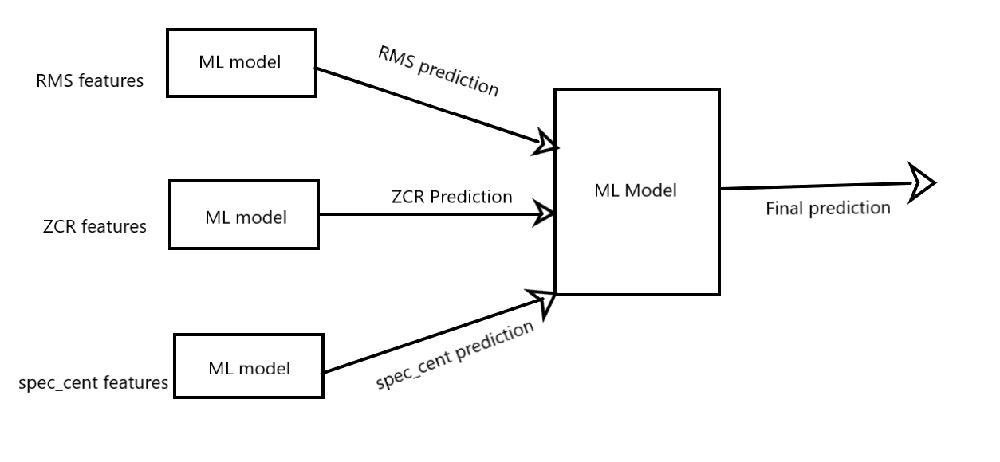

In [ ]:
from IPython.display import Image
Image(filename='model.png',width = 700, height = 500) 

#### Note: I'll be running file from top to bottom with same random state to make sure for all the three feature tarin and test data are same as we will be later comparing prediction result with this test data only.

In [ ]:
import os #Importing files with proper naming format after preprocessing
MLENDHW_table = [] 
files=os.listdir("G:/audio/potter_star/")
for file in files:
    print(file)
    file_name = file.split('\\')[-1]
    print("file name:",file_name)
    participant_ID = file.split('\\')[-1].split('_')[0]
    print("part number:",participant_ID)
    interpretation_type = file.split('\\')[-1].split('_')[1]
    print("inter type:",interpretation_type)
    interpretation_number = file.split('\\')[-1].split('_')[2]
    print("inter number:",interpretation_number)
    song = file.split('\\')[-1].split('_')[-1].split('.')[0]
    print("song:",song)
    MLENDHW_table.append([file_name,participant_ID,interpretation_type,interpretation_number, song])

MLENDHW_table

S100_hum_1_Potter.wav
file name: S100_hum_1_Potter.wav
part number: S100
inter type: hum
inter number: 1
song: Potter
S100_hum_2_Potter.wav
file name: S100_hum_2_Potter.wav
part number: S100
inter type: hum
inter number: 2
song: Potter
S100_hum_3_StarWars.wav
file name: S100_hum_3_StarWars.wav
part number: S100
inter type: hum
inter number: 3
song: StarWars
S100_hum_4_StarWars.wav
file name: S100_hum_4_StarWars.wav
part number: S100
inter type: hum
inter number: 4
song: StarWars
S101_hum_1_Potter.wav
file name: S101_hum_1_Potter.wav
part number: S101
inter type: hum
inter number: 1
song: Potter
S101_hum_2_Potter.wav
file name: S101_hum_2_Potter.wav
part number: S101
inter type: hum
inter number: 2
song: Potter
S101_hum_3_StarWars.wav
file name: S101_hum_3_StarWars.wav
part number: S101
inter type: hum
inter number: 3
song: StarWars
S101_hum_4_StarWars.wav
file name: S101_hum_4_StarWars.wav
part number: S101
inter type: hum
inter number: 4
song: StarWars
S102_hum_2_Potter.wav
file name:

song: Potter
S146_hum_1_StarWars.wav
file name: S146_hum_1_StarWars.wav
part number: S146
inter type: hum
inter number: 1
song: StarWars
S146_hum_3_Potter.wav
file name: S146_hum_3_Potter.wav
part number: S146
inter type: hum
inter number: 3
song: Potter
S146_hum_4_StarWars.wav
file name: S146_hum_4_StarWars.wav
part number: S146
inter type: hum
inter number: 4
song: StarWars
S147_hum_2_Potter.wav
file name: S147_hum_2_Potter.wav
part number: S147
inter type: hum
inter number: 2
song: Potter
S147_hum_2_StarWars.wav
file name: S147_hum_2_StarWars.wav
part number: S147
inter type: hum
inter number: 2
song: StarWars
S147_whistle_2_Potter.wav
file name: S147_whistle_2_Potter.wav
part number: S147
inter type: whistle
inter number: 2
song: Potter
S147_whistle_2_StarWars.wav
file name: S147_whistle_2_StarWars.wav
part number: S147
inter type: whistle
inter number: 2
song: StarWars
S148_hum_1_Potter.wav
file name: S148_hum_1_Potter.wav
part number: S148
inter type: hum
inter number: 1
song: Po

song: StarWars
S187_hum_2_Potter.wav
file name: S187_hum_2_Potter.wav
part number: S187
inter type: hum
inter number: 2
song: Potter
S187_hum_2_StarWars.wav
file name: S187_hum_2_StarWars.wav
part number: S187
inter type: hum
inter number: 2
song: StarWars
S187_whistle_2_Potter.wav
file name: S187_whistle_2_Potter.wav
part number: S187
inter type: whistle
inter number: 2
song: Potter
S187_whistle_2_StarWars.wav
file name: S187_whistle_2_StarWars.wav
part number: S187
inter type: whistle
inter number: 2
song: StarWars
S188_hum_2_Potter.wav
file name: S188_hum_2_Potter.wav
part number: S188
inter type: hum
inter number: 2
song: Potter
S188_hum_2_StarWars.wav
file name: S188_hum_2_StarWars.wav
part number: S188
inter type: hum
inter number: 2
song: StarWars
S188_whistle_2_Potter.wav
file name: S188_whistle_2_Potter.wav
part number: S188
inter type: whistle
inter number: 2
song: Potter
S188_whistle_2_StarWars.wav
file name: S188_whistle_2_StarWars.wav
part number: S188
inter type: whistle


file name: S31_hum_1_Potter.wav
part number: S31
inter type: hum
inter number: 1
song: Potter
S31_hum_2_Potter.wav
file name: S31_hum_2_Potter.wav
part number: S31
inter type: hum
inter number: 2
song: Potter
S31_hum_3_StarWars.wav
file name: S31_hum_3_StarWars.wav
part number: S31
inter type: hum
inter number: 3
song: StarWars
S31_hum_4_StarWars.wav
file name: S31_hum_4_StarWars.wav
part number: S31
inter type: hum
inter number: 4
song: StarWars
S32_hum_2_Potter.wav
file name: S32_hum_2_Potter.wav
part number: S32
inter type: hum
inter number: 2
song: Potter
S32_hum_2_StarWars.wav
file name: S32_hum_2_StarWars.wav
part number: S32
inter type: hum
inter number: 2
song: StarWars
S32_whistle_2_Potter.wav
file name: S32_whistle_2_Potter.wav
part number: S32
inter type: whistle
inter number: 2
song: Potter
S32_whistle_2_StarWars.wav
file name: S32_whistle_2_StarWars.wav
part number: S32
inter type: whistle
inter number: 2
song: StarWars
S34_hum_2_Potter.wav
file name: S34_hum_2_Potter.wav


part number: S78
inter type: whistle
inter number: 2
song: StarWars
S79_hum_1_Potter.wav
file name: S79_hum_1_Potter.wav
part number: S79
inter type: hum
inter number: 1
song: Potter
S79_hum_3_StarWars.wav
file name: S79_hum_3_StarWars.wav
part number: S79
inter type: hum
inter number: 3
song: StarWars
S79_hum_4_Potter.wav
file name: S79_hum_4_Potter.wav
part number: S79
inter type: hum
inter number: 4
song: Potter
S79_hum_4_StarWars.wav
file name: S79_hum_4_StarWars.wav
part number: S79
inter type: hum
inter number: 4
song: StarWars
S7_hum_1_Potter.wav
file name: S7_hum_1_Potter.wav
part number: S7
inter type: hum
inter number: 1
song: Potter
S7_hum_2_Potter.wav
file name: S7_hum_2_Potter.wav
part number: S7
inter type: hum
inter number: 2
song: Potter
S7_hum_3_StarWars.wav
file name: S7_hum_3_StarWars.wav
part number: S7
inter type: hum
inter number: 3
song: StarWars
S7_hum_4_StarWars.wav
file name: S7_hum_4_StarWars.wav
part number: S7
inter type: hum
inter number: 4
song: StarWars


[['S100_hum_1_Potter.wav', 'S100', 'hum', '1', 'Potter'],
 ['S100_hum_2_Potter.wav', 'S100', 'hum', '2', 'Potter'],
 ['S100_hum_3_StarWars.wav', 'S100', 'hum', '3', 'StarWars'],
 ['S100_hum_4_StarWars.wav', 'S100', 'hum', '4', 'StarWars'],
 ['S101_hum_1_Potter.wav', 'S101', 'hum', '1', 'Potter'],
 ['S101_hum_2_Potter.wav', 'S101', 'hum', '2', 'Potter'],
 ['S101_hum_3_StarWars.wav', 'S101', 'hum', '3', 'StarWars'],
 ['S101_hum_4_StarWars.wav', 'S101', 'hum', '4', 'StarWars'],
 ['S102_hum_2_Potter.wav', 'S102', 'hum', '2', 'Potter'],
 ['S102_whistle_1_StarWars.wav', 'S102', 'whistle', '1', 'StarWars'],
 ['S102_whistle_2_Potter.wav', 'S102', 'whistle', '2', 'Potter'],
 ['S102_whistle_2_StarWars.wav', 'S102', 'whistle', '2', 'StarWars'],
 ['S103_hum_2_Potter.wav', 'S103', 'hum', '2', 'Potter'],
 ['S103_hum_2_StarWars.wav', 'S103', 'hum', '2', 'StarWars'],
 ['S103_whistle_2_Potter.wav', 'S103', 'whistle', '2', 'Potter'],
 ['S103_whistle_2_StarWars.wav', 'S103', 'whistle', '2', 'StarWars'],


In [ ]:
MLENDHW_df = pd.DataFrame(MLENDHW_table,columns=['file_id','participant','interpretation','number','song']).set_index('file_id') 
MLENDHW_df

,participant,interpretation,number,song
file_id,,,,
S100_hum_1_Potter.wav,S100,hum,1,Potter
S100_hum_2_Potter.wav,S100,hum,2,Potter
S100_hum_3_StarWars.wav,S100,hum,3,StarWars
S100_hum_4_StarWars.wav,S100,hum,4,StarWars
S101_hum_1_Potter.wav,S101,hum,1,Potter
...,...,...,...,...
S99_whistle_1_Potter.wav,S99,whistle,1,Potter
S9_hum_1_Potter.wav,S9,hum,1,Potter
S9_hum_2_Potter.wav,S9,hum,2,Potter


In [ ]:
MLENDHW_df.song.value_counts()

Potter      410
StarWars    408
Name: song, dtype: int64

In [ ]:
MLENDHW_df.interpretation.value_counts()

hum        588
whistle    230
Name: interpretation, dtype: int64

# 5. Modelling

Since this is a classification problem we will be using different classifiers.

For my modelling I have tried using different types of classifiers ensembel, trees and neural. Following are the classifiers I'll be using and comapre the models:
1. AdaBoostClassifier(),
2. BaggingClassifier(),
3. ExtraTreesClassifier(),
4. GradientBoostingClassifier(),
5. RandomForestClassifier(),
6. KNeighborsClassifier(),
7. SVC(),
8. DecisionTreeClassifier(),
10. XGBClassifier(),
11. MLPClassifier()

In [ ]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn import ensemble, linear_model, neighbors, svm, tree, neural_network
from sklearn.pipeline import make_pipeline
from sklearn import svm,model_selection, tree, linear_model, neighbors, naive_bayes, ensemble, discriminant_analysis, gaussian_process
from xgboost.sklearn import XGBClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import BernoulliRBM, MLPClassifier, MLPRegressor

In [ ]:
MLA = [
    #Ensemble Methods
    ensemble.AdaBoostClassifier(),
    ensemble.BaggingClassifier(),
    ensemble.ExtraTreesClassifier(),
    ensemble.GradientBoostingClassifier(),
    ensemble.RandomForestClassifier(),

  

    #Nearest Neighbor
    neighbors.KNeighborsClassifier(),
    
    #SVM
    svm.SVC(),

    
    #Trees    
    tree.DecisionTreeClassifier(),
    
    
    XGBClassifier(),
    MLPClassifier()
    
    ]

### Function where it calculate each model accuracy,precision and recall for training and testing dataset

In [ ]:
def best_model(X_train,y_train,X_val,y_val):
    MLA_columns = []
    MLA_compare = pd.DataFrame(columns = MLA_columns)


    row_index = 0
    for alg in MLA:
        alg.fit(X_train, y_train)
        predicted_train=alg.predict(X_train)
        predicted_test=alg.predict(X_val)

        MLA_name = alg.__class__.__name__
        MLA_compare.loc[row_index,'MLA Name'] = MLA_name
        MLA_compare.loc[row_index, 'MLA Train accuracy']= round(metrics.accuracy_score(y_train, predicted_train),4)
        MLA_compare.loc[row_index, 'MLA Val accuracy']= round(metrics.accuracy_score(y_val, predicted_test),4)
        MLA_compare.loc[row_index, 'MLA Train precision'] = round(metrics.precision_score(y_train, predicted_train), 4)
        MLA_compare.loc[row_index, 'MLA Test precision'] = round(metrics.precision_score(y_val, predicted_test), 4)
        MLA_compare.loc[row_index, 'Train recall'] = round(metrics.recall_score(y_train,predicted_train),4)
        MLA_compare.loc[row_index, 'Test recall'] = round(metrics.recall_score(y_val,predicted_test),4)

        row_index+=1

    MLA_compare.sort_values(by = ['MLA Val accuracy'], ascending = False, inplace = True)    
    return MLA_compare

# 6.Transformation Stage

As discussed earlier in this stage I'm extracting three features namely root-mean-square (RMS), zero-crossing rate and spectral centroid value for each frame.

In [ ]:
path="G:/audio/potter_star/"
file_name=[]
for i in files:
    i = path + i
    file_name.append(i)

### RMS

root-mean-square (RMS) value for each frame, from the audio samples

In [ ]:
def rms(files,labels_file, scale_audio=False, onlySingleDigit=False):
    X_rms,y_rms =[],[]
    for file in tqdm(files):
        fileID = file.split('/')[-1]
        file_name = file.split('/')[-1]
        yi = labels_file.loc[fileID]['song']=='Potter'

        fs = None # if None, fs would be 22050
        audio_data, fs = librosa.load(file,sr=fs)

        rms = librosa.feature.rms(audio_data)[0]
        xi = [rms]  

        X_rms.append(xi)
        y_rms.append(yi)

    return np.array(X_rms),np.array(y_rms) #Returns rms value of each frame
    

In [ ]:
#Computing RMS value
X_rms_x,y_rms_y = rms(file_name, labels_file=MLENDHW_df, scale_audio=True, onlySingleDigit=True) 

100%|██████████| 818/818 [00:29<00:00, 27.98it/s]


In [ ]:
X_rms_x_df=pd.DataFrame(X_rms_x) #Converting it into dataframe
X_rms_x_df

,0
0,"[4.3472017e-05, 4.421363e-05, 4.489492e-05, 4...."
1,"[4.6012934e-05, 4.5073095e-05, 4.5964727e-05, ..."
2,"[4.66058e-05, 4.5878078e-05, 4.5020093e-05, 4...."
3,"[3.969222e-05, 4.23151e-05, 4.3879383e-05, 4.3..."
4,"[4.5338413e-05, 4.5686873e-05, 4.5137367e-05, ..."
...,...
813,"[0.00017017341, 0.00016877342, 0.00014619433, ..."
814,"[0.0033185894, 0.0030664732, 0.002900661, 0.00..."
815,"[0.07468246, 0.0742588, 0.068007044, 0.0589942..."
816,"[0.0042437427, 0.004354085, 0.003729359, 0.002..."


#### As we can see each row is composed of rms values but in just one column. For ML model this is not the correct format of input. Trying to input this in ML model will generate error therefore I seperated this compresed format into single single columns

In [ ]:
rms_df=pd.DataFrame()
for i in range(0,X_rms_x_df.shape[0]):
    rms_df=rms_df.append(pd.DataFrame(X_rms_x_df[0][i]).T)

In [ ]:
rms_df

,0,1,2,3,4,5,6,7,8,9,...,2641,2642,2643,2644,2645,2646,2647,2648,2649,2650
0,0.000043,0.000044,0.000045,0.000045,0.000047,0.000046,0.000046,0.000046,0.000044,0.000043,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,0.000046,0.000045,0.000046,0.000045,0.000046,0.000046,0.000044,0.000045,0.000043,0.000044,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,0.000047,0.000046,0.000045,0.000045,0.000043,0.000043,0.000045,0.000045,0.000046,0.000046,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,0.000040,0.000042,0.000044,0.000044,0.000045,0.000044,0.000044,0.000046,0.000045,0.000046,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,0.000045,0.000046,0.000045,0.000044,0.000045,0.000045,0.000046,0.000047,0.000047,0.000047,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,0.000170,0.000169,0.000146,0.000292,0.003398,0.004220,0.004567,0.004588,0.003122,0.001884,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,0.003319,0.003066,0.002901,0.002829,0.002706,0.003078,0.003030,0.002850,0.002713,0.002208,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,0.074682,0.074259,0.068007,0.058994,0.053038,0.046839,0.042474,0.039375,0.036919,0.033350,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,0.004244,0.004354,0.003729,0.002832,0.003389,0.003405,0.003668,0.003647,0.003156,0.002978,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### We can see that we have received many null values. Reason for this null value is that as each audio signal is not of same length and don't have same frames therefore audio signal having shorter length and low frames have high number of null. 

In [ ]:
rms_df.isnull().sum()

0         0
1         0
2         0
3         0
4         0
       ... 
2646    817
2647    817
2648    817
2649    817
2650    817
Length: 2651, dtype: int64

#### I have replaced null values with '0' because it make sense '0' means no signal. I didn't opt for drop as I didn't wanted to lose data with repective to each frame for longer duration and high frames.

In [ ]:
rms_df.fillna(0,inplace=True)

In [ ]:
rms_df.isnull().sum()

0       0
1       0
2       0
3       0
4       0
       ..
2646    0
2647    0
2648    0
2649    0
2650    0
Length: 2651, dtype: int64

#### Applying PCA as we have high dimensions 

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler() #Normalizing the data before PCA
scaler.fit(rms_df)
scaled_data=scaler.transform(rms_df)

In [ ]:
from sklearn.decomposition import PCA
pca=PCA(n_components=200) 
pca.fit(scaled_data)
x_pca=pca.transform(scaled_data)

In [ ]:
print (pca.explained_variance_ratio_.cumsum())

[0.24127232 0.38902354 0.4487865  0.49418932 0.5319472  0.5647801
 0.5928191  0.617308   0.6403095  0.6622583  0.6808422  0.69519025
 0.7084643  0.7210963  0.7329709  0.7432956  0.75356317 0.76262915
 0.7710256  0.7792145  0.7868268  0.7939183  0.80090255 0.8075767
 0.8141565  0.8202697  0.82613164 0.83174425 0.83734727 0.8425384
 0.8474042  0.85202765 0.8564803  0.86075306 0.8649098  0.86896366
 0.8727164  0.87623584 0.87966764 0.88295513 0.88614315 0.8892724
 0.89220333 0.8950387  0.8978304  0.9005483  0.90323234 0.9057176
 0.9081586  0.9105157  0.91283536 0.9150467  0.9172286  0.9193579
 0.92131466 0.92322564 0.92509085 0.92687607 0.9285811  0.93026084
 0.9318734  0.93345743 0.935032   0.9365122  0.9379785  0.93934536
 0.94067156 0.94198185 0.9432659  0.9445464  0.94577235 0.9469888
 0.9481842  0.949348   0.9504631  0.95156616 0.9526472  0.9537013
 0.9547145  0.9556892  0.956622   0.95751673 0.95840603 0.95927304
 0.9601218  0.9609549  0.96176827 0.9625364  0.9633002  0.96404403
 0.

#### I have chose n_components as 200 because from pca.explained_variance_ratio_.cumsum() we can see it covers aprroximately 99% variance of true data set. 

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(x_pca,y_rms_y,test_size=0.3,random_state=2)
X_train.shape, X_val.shape, y_train.shape, y_val.shape

((572, 200), (246, 200), (572,), (246,))

In [ ]:
rms_models=best_model(X_train,y_train,X_val,y_val)

C:\Users\Swati\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:617: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


In [ ]:
rms_models

,MLA Name,MLA Train accuracy,MLA Val accuracy,MLA Train precision,MLA Test precision,Train recall,Test recall
3,GradientBoostingClassifier,1.0000,0.6667,1.0000,0.6471,1.0000,0.7213
4,RandomForestClassifier,1.0000,0.6504,1.0000,0.6607,1.0000,0.6066
2,ExtraTreesClassifier,1.0000,0.6463,1.0000,0.6636,1.0000,0.5820
9,MLPClassifier,0.9930,0.6463,0.9897,0.6296,0.9965,0.6967
8,XGBClassifier,1.0000,0.6341,1.0000,0.6270,1.0000,0.6475
5,KNeighborsClassifier,0.7902,0.6301,0.7414,0.6013,0.8958,0.7541
1,BaggingClassifier,0.9860,0.6220,0.9965,0.6526,0.9757,0.5082
6,SVC,0.7150,0.5976,0.6551,0.5635,0.9167,0.8361
0,AdaBoostClassifier,0.9143,0.5854,0.9223,0.5781,0.9062,0.6066
7,DecisionTreeClassifier,1.0000,0.5732,1.0000,0.5680,1.0000,0.5820


In [ ]:
x_pca.shape

(818, 200)

In [ ]:
model = ensemble.GradientBoostingClassifier()
model.fit(X_train, y_train)
predict_train = model.predict(X_train)
predict_test = model.predict(X_val)
print('Training Accuracy:', metrics.accuracy_score(y_train, predict_train))
print('Validation Accuracy:', metrics.accuracy_score(y_val, predict_test))

Training Accuracy: 1.0
Validation Accuracy: 0.6666666666666666


In [ ]:
model_rms_y_pred = model.predict(X_val)
model_rms_y_pred_df=pd.DataFrame(model_rms_y_pred,columns=['rms'])
#model_rms_y_pred_df.to_csv("rms_pca_tpot.csv")

### Zerocrossing rate

zero-crossing rate of an audio time series

In [ ]:
def zcr(files,labels_file, scale_audio=False, onlySingleDigit=False):
    X_zcr,y_zcr =[],[]
    for file in tqdm(files):
        fileID = file.split('/')[-1]
        file_name = file.split('/')[-1]
        yi = labels_file.loc[fileID]['song']=='Potter'

        fs = None # if None, fs would be 22050
        audio_data, fs = librosa.load(file,sr=fs)

        zcr = librosa.feature.zero_crossing_rate(audio_data)[0]

        xi = [zcr]  
        X_zcr.append(xi)
        y_zcr.append(yi)

    return np.array(X_zcr),np.array(y_zcr)

In [ ]:
X_zcr_x,y_zcr_y = zcr(file_name, labels_file=MLENDHW_df, scale_audio=True, onlySingleDigit=True)

100%|██████████| 818/818 [00:32<00:00, 24.92it/s]


In [ ]:
X_zcr_x_df=pd.DataFrame(X_zcr_x)
X_zcr_x_df

,0
0,"[0.390625, 0.5869140625, 0.77880859375, 0.7841..."
1,"[0.3984375, 0.6005859375, 0.7939453125, 0.7890..."
2,"[0.3935546875, 0.59130859375, 0.7822265625, 0...."
3,"[0.3955078125, 0.59765625, 0.79638671875, 0.79..."
4,"[0.39306640625, 0.587890625, 0.78564453125, 0...."
...,...
813,"[0.10205078125, 0.16650390625, 0.220703125, 0...."
814,"[0.0615234375, 0.11865234375, 0.154296875, 0.1..."
815,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
816,"[0.06298828125, 0.0947265625, 0.1220703125, 0...."


#### As we can see each row is composed of rms values but in just one column. For ML model this is not the correct format of input. Trying to input this in ML model will generate error therefore I seperated this compresed format into single single columns

In [ ]:
zcr_df=pd.DataFrame()
for i in range(0,X_zcr_x_df.shape[0]):
    zcr_df=zcr_df.append(pd.DataFrame(X_zcr_x_df[0][i]).T)

In [ ]:
zcr_df

,0,1,2,3,4,5,6,7,8,9,...,2641,2642,2643,2644,2645,2646,2647,2648,2649,2650
0,0.390625,0.586914,0.778809,0.784180,0.789062,0.789551,0.786621,0.790039,0.782227,0.779297,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,0.398438,0.600586,0.793945,0.789062,0.798340,0.795410,0.804199,0.801758,0.795898,0.788086,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,0.393555,0.591309,0.782227,0.792969,0.774902,0.778320,0.788086,0.781738,0.796387,0.791016,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,0.395508,0.597656,0.796387,0.795898,0.795410,0.797363,0.799805,0.796875,0.797852,0.798340,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,0.393066,0.587891,0.785645,0.788086,0.798828,0.808594,0.813965,0.805664,0.802734,0.790527,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,0.102051,0.166504,0.220703,0.228516,0.166016,0.105957,0.053711,0.021484,0.020508,0.025391,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,0.061523,0.118652,0.154297,0.154297,0.175293,0.152344,0.167480,0.204102,0.200684,0.229492,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,0.062988,0.094727,0.122070,0.158203,0.132812,0.128906,0.118164,0.110840,0.129883,0.151855,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### We can see that we have received many null values. Reason for this null value is that as each audio signal is not of same length and don't have same frames therefore audio signal having shorter length and low frames have high number of null. 

In [ ]:
zcr_df.isnull().sum().head()

0    0
1    0
2    0
3    0
4    0
dtype: int64

#### I have replaced null values with '0' because it make sense '0' means no signal. I didn't opt for drop as I didn't wanted to lose data with repective to each frame for longer duration and high frames.

In [ ]:
zcr_df.fillna(0,inplace=True)

In [ ]:
zcr_df.isnull().sum()

0       0
1       0
2       0
3       0
4       0
       ..
2646    0
2647    0
2648    0
2649    0
2650    0
Length: 2651, dtype: int64

#### Applying PCA as we have high dimensions 

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
scaler.fit(zcr_df)
scaled_data=scaler.transform(zcr_df)
scaled_data.shape

(818, 2651)

In [ ]:
from sklearn.decomposition import PCA
pca=PCA(n_components=220)
pca.fit(scaled_data)
x_pca=pca.transform(scaled_data)

In [ ]:
print (pca.explained_variance_ratio_.cumsum())

[0.20485194 0.35205773 0.42567252 0.46882576 0.50005306 0.52785587
 0.55088832 0.57151241 0.58988402 0.60546178 0.61986758 0.63338783
 0.64663051 0.65958903 0.67177581 0.68212645 0.69202949 0.70132922
 0.71029092 0.7189204  0.72733771 0.73499733 0.74235741 0.74953983
 0.75643121 0.76321286 0.76980052 0.77572474 0.78142825 0.78688326
 0.79226817 0.79737846 0.80234467 0.80722321 0.8119525  0.81646685
 0.82070461 0.82487481 0.82895848 0.83287927 0.83673457 0.84046518
 0.84403243 0.8474274  0.85077356 0.85401242 0.85720804 0.86025773
 0.86320594 0.86611524 0.86891913 0.87162359 0.87426785 0.87683905
 0.87930313 0.8817541  0.88409001 0.8864038  0.88866735 0.89092101
 0.89313966 0.89522742 0.89725198 0.89923915 0.90122168 0.90313659
 0.90502805 0.90686607 0.90869118 0.91042991 0.91215995 0.91383424
 0.91544364 0.91701989 0.91856172 0.92007805 0.9215263  0.92296322
 0.92437817 0.92577158 0.92713191 0.92846354 0.92977895 0.93106996
 0.932318   0.93351524 0.93470251 0.93587703 0.9370019  0.9380

#### I have chose n_components as 220 because from pca.explained_variance_ratio_.cumsum() we can see it covers aprroximately 99% variance of true data set. 

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(x_pca,y_zcr_y,test_size=0.3,random_state=2)
X_train.shape, X_val.shape, y_train.shape, y_val.shape

((572, 220), (246, 220), (572,), (246,))

In [ ]:
zcr_models=best_model(X_train,y_train,X_val,y_val)

C:\Users\Swati\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:617: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


In [ ]:
zcr_models

,MLA Name,MLA Train accuracy,MLA Val accuracy,MLA Train precision,MLA Test precision,Train recall,Test recall
3,GradientBoostingClassifier,1.0000,0.6829,1.0000,0.6803,1.0000,0.6803
8,XGBClassifier,1.0000,0.6789,1.0000,0.6641,1.0000,0.7131
9,MLPClassifier,1.0000,0.6545,1.0000,0.6434,1.0000,0.6803
4,RandomForestClassifier,1.0000,0.6260,1.0000,0.6230,1.0000,0.6230
5,KNeighborsClassifier,0.7832,0.6260,0.7611,0.6042,0.8299,0.7131
6,SVC,0.7902,0.6057,0.8022,0.5940,0.7743,0.6475
7,DecisionTreeClassifier,1.0000,0.6057,1.0000,0.6000,1.0000,0.6148
2,ExtraTreesClassifier,1.0000,0.5935,1.0000,0.5965,1.0000,0.5574
0,AdaBoostClassifier,0.9021,0.5854,0.8893,0.5794,0.9201,0.5984
1,BaggingClassifier,0.9860,0.5488,0.9965,0.5579,0.9757,0.4344


In [ ]:
model = ensemble.GradientBoostingClassifier()
model.fit(X_train, y_train)
predict_train = model.predict(X_train)
predict_test = model.predict(X_val)
print('Training Accuracy:', metrics.accuracy_score(y_train, predict_train))
print('Validation Accuracy:', metrics.accuracy_score(y_val, predict_test))

Training Accuracy: 1.0
Validation Accuracy: 0.6829268292682927


In [ ]:
model_zcr_y_pred = model.predict(X_val)
model_zcr_y_pred_df=pd.DataFrame(model_zcr_y_pred,columns=['zcr'])
#model_zcr_y_pred_df.to_csv("zcr_pca_tpot.csv")

### Spectral centroid.


Compute the spectral centroid.

Each frame of a magnitude spectrogram is normalized and treated as a distribution over frequency bins, from which the mean (centroid) is extracted per frame.

In [ ]:
def spec_cent(files,labels_file, scale_audio=False, onlySingleDigit=False):
    X_spec_cent,y_spec_cent =[],[]
    for file in tqdm(files):
        fileID = file.split('/')[-1]
        file_name = file.split('/')[-1]
        yi = labels_file.loc[fileID]['song']=='Potter'

        fs = None # if None, fs would be 22050
        audio_data, fs = librosa.load(file,sr=fs)


        spec_cent=librosa.feature.spectral_centroid(audio_data)[0]


        xi = spec_cent
        X_spec_cent.append(spec_cent)
        y_spec_cent.append(yi)

    return np.array(X_spec_cent),np.array(y_spec_cent)

In [ ]:
X_spec_cent_x,y_spec_cent_y = zcr(file_name, labels_file=MLENDHW_df, scale_audio=True, onlySingleDigit=True)

100%|██████████| 818/818 [00:32<00:00, 24.89it/s]


In [ ]:
X_spec_cent_x_df=pd.DataFrame(X_spec_cent_x)
X_spec_cent_x_df

,0
0,"[0.390625, 0.5869140625, 0.77880859375, 0.7841..."
1,"[0.3984375, 0.6005859375, 0.7939453125, 0.7890..."
2,"[0.3935546875, 0.59130859375, 0.7822265625, 0...."
3,"[0.3955078125, 0.59765625, 0.79638671875, 0.79..."
4,"[0.39306640625, 0.587890625, 0.78564453125, 0...."
...,...
813,"[0.10205078125, 0.16650390625, 0.220703125, 0...."
814,"[0.0615234375, 0.11865234375, 0.154296875, 0.1..."
815,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
816,"[0.06298828125, 0.0947265625, 0.1220703125, 0...."


#### As we can see each row is composed of rms values but in just one column. For ML model this is not the correct format of input. Trying to input this in ML model will generate error therefore I seperated this compresed format into single single columns

In [ ]:
spec_cent_df=pd.DataFrame()
for i in range(0,X_spec_cent_x_df.shape[0]):
    spec_cent_df=spec_cent_df.append(pd.DataFrame(X_spec_cent_x_df[0][i]).T)

In [ ]:
spec_cent_df

,0,1,2,3,4,5,6,7,8,9,...,2641,2642,2643,2644,2645,2646,2647,2648,2649,2650
0,0.390625,0.586914,0.778809,0.784180,0.789062,0.789551,0.786621,0.790039,0.782227,0.779297,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,0.398438,0.600586,0.793945,0.789062,0.798340,0.795410,0.804199,0.801758,0.795898,0.788086,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,0.393555,0.591309,0.782227,0.792969,0.774902,0.778320,0.788086,0.781738,0.796387,0.791016,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,0.395508,0.597656,0.796387,0.795898,0.795410,0.797363,0.799805,0.796875,0.797852,0.798340,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,0.393066,0.587891,0.785645,0.788086,0.798828,0.808594,0.813965,0.805664,0.802734,0.790527,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,0.102051,0.166504,0.220703,0.228516,0.166016,0.105957,0.053711,0.021484,0.020508,0.025391,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,0.061523,0.118652,0.154297,0.154297,0.175293,0.152344,0.167480,0.204102,0.200684,0.229492,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,0.062988,0.094727,0.122070,0.158203,0.132812,0.128906,0.118164,0.110840,0.129883,0.151855,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### We can see that we have received many null values. Reason for this null value is that as each audio signal is not of same length and don't have same frames therefore audio signal having shorter length and low frames have high number of null. 

In [ ]:
spec_cent_df.isnull().sum()

0         0
1         0
2         0
3         0
4         0
       ... 
2646    817
2647    817
2648    817
2649    817
2650    817
Length: 2651, dtype: int64

#### I have replaced null values with '0' because it make sense '0' means no signal. I didn't opt for drop as I didn't wanted to lose data with repective to each frame for longer duration and high frames.

In [ ]:
spec_cent_df.fillna(0,inplace=True)

In [ ]:
spec_cent_df.isnull().sum()

0       0
1       0
2       0
3       0
4       0
       ..
2646    0
2647    0
2648    0
2649    0
2650    0
Length: 2651, dtype: int64

#### Applying PCA as we have high dimensions 

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
scaler.fit(spec_cent_df)
scaled_data=scaler.transform(spec_cent_df)

In [ ]:
scaled_data=scaler.transform(spec_cent_df)
from sklearn.decomposition import PCA
pca=PCA(n_components=200)
pca.fit(scaled_data)
x_pca=pca.transform(scaled_data)

In [ ]:
print (pca.explained_variance_ratio_.cumsum())

[0.20485194 0.35205773 0.42567252 0.46882576 0.50005306 0.52785587
 0.55088832 0.57151241 0.58988402 0.60546178 0.61986758 0.63338783
 0.64663051 0.65958903 0.67177581 0.68212645 0.69202949 0.70132922
 0.71029092 0.7189204  0.72733771 0.73499733 0.74235741 0.74953983
 0.75643121 0.76321286 0.76980052 0.77572474 0.78142825 0.78688326
 0.79226817 0.79737846 0.80234467 0.80722321 0.8119525  0.81646685
 0.82070461 0.82487481 0.82895848 0.83287927 0.83673457 0.84046518
 0.84403243 0.8474274  0.85077356 0.85401242 0.85720804 0.86025773
 0.86320594 0.86611524 0.86891913 0.87162359 0.87426785 0.87683905
 0.87930313 0.8817541  0.88409001 0.8864038  0.88866735 0.89092101
 0.89313966 0.89522742 0.89725198 0.89923915 0.90122168 0.90313659
 0.90502805 0.90686607 0.90869118 0.91042991 0.91215995 0.91383424
 0.91544364 0.91701989 0.91856172 0.92007805 0.9215263  0.92296322
 0.92437817 0.92577158 0.92713191 0.92846354 0.92977895 0.93106996
 0.932318   0.93351524 0.93470251 0.93587703 0.9370019  0.9380

#### I have chose n_components as 200 because from pca.explained_variance_ratio_.cumsum() we can see it covers aprroximately 99% variance of true data set. 

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(x_pca,y_spec_cent_y,test_size=0.3,random_state=2)
X_train.shape, X_val.shape, y_train.shape, y_val.shape

((572, 200), (246, 200), (572,), (246,))

In [ ]:
spec_cent_models=best_model(X_train,y_train,X_val,y_val)

C:\Users\Swati\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:617: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


In [ ]:
spec_cent_models

,MLA Name,MLA Train accuracy,MLA Val accuracy,MLA Train precision,MLA Test precision,Train recall,Test recall
3,GradientBoostingClassifier,1.0000,0.6911,1.0000,0.6769,1.0000,0.7213
8,XGBClassifier,1.0000,0.6789,1.0000,0.6641,1.0000,0.7131
4,RandomForestClassifier,1.0000,0.6463,1.0000,0.6496,1.0000,0.6230
9,MLPClassifier,1.0000,0.6382,1.0000,0.6260,1.0000,0.6721
0,AdaBoostClassifier,0.9038,0.6220,0.9059,0.6160,0.9028,0.6311
5,KNeighborsClassifier,0.7885,0.6179,0.7702,0.5972,0.8264,0.7049
2,ExtraTreesClassifier,1.0000,0.6057,1.0000,0.6087,1.0000,0.5738
6,SVC,0.7902,0.5894,0.8043,0.5766,0.7708,0.6475
1,BaggingClassifier,0.9878,0.5691,1.0000,0.5889,0.9757,0.4344
7,DecisionTreeClassifier,1.0000,0.5610,1.0000,0.5614,1.0000,0.5246


In [ ]:
model = ensemble.GradientBoostingClassifier()
model.fit(X_train, y_train)
predict_train = model.predict(X_train)
predict_test = model.predict(X_val)
print('Training Accuracy:', metrics.accuracy_score(y_train, predict_train))
print('Validation Accuracy:', metrics.accuracy_score(y_val, predict_test))

Training Accuracy: 1.0
Validation Accuracy: 0.6951219512195121


In [ ]:
model_svc_y_pred = model.predict(X_val)
model_svc_y_pred_df=pd.DataFrame(model_svc_y_pred,columns=['spec_cent'])
#model_svc_y_pred_df.to_csv("spec_cent_pca_tpot.csv")

## Now I have concatinated the dataframe of three features where it is predicted result of it's respective model

In [ ]:
frames=[model_rms_y_pred_df,model_zcr_y_pred_df,model_svc_y_pred_df]
all_three=pd.concat(frames,axis=1)

In [ ]:
all_three.isnull().sum()

rms          0
zcr          0
spec_cent    0
dtype: int64

In [ ]:
all_three['actual']=y_val #This is the actual song label of this split

In [ ]:
X=all_three.loc[:, all_three.columns != 'actual']
y=all_three['actual']

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(X,y,test_size=0.2,random_state=2)
X_train.shape, X_val.shape, y_train.shape, y_val.shape

((196, 3), (50, 3), (196,), (50,))

# 7. Methodology

In [ ]:
all_models=best_model(X_train,y_train,X_val,y_val)

In [ ]:
all_models

,MLA Name,MLA Train accuracy,MLA Val accuracy,MLA Train precision,MLA Test precision,Train recall,Test recall
0,AdaBoostClassifier,0.7194,0.72,0.7019,0.7037,0.7526,0.76
1,BaggingClassifier,0.7194,0.72,0.7019,0.7037,0.7526,0.76
2,ExtraTreesClassifier,0.7245,0.72,0.8028,0.7619,0.5876,0.64
3,GradientBoostingClassifier,0.7245,0.72,0.8028,0.7619,0.5876,0.64
4,RandomForestClassifier,0.7194,0.72,0.7019,0.7037,0.7526,0.76
5,KNeighborsClassifier,0.7194,0.72,0.7019,0.7037,0.7526,0.76
6,SVC,0.7245,0.72,0.8028,0.7619,0.5876,0.64
7,DecisionTreeClassifier,0.7245,0.72,0.8028,0.7619,0.5876,0.64
8,XGBClassifier,0.7245,0.72,0.8028,0.7619,0.5876,0.64
9,MLPClassifier,0.7245,0.72,0.8028,0.7619,0.5876,0.64


In [ ]:
model = ensemble.AdaBoostClassifier()
model.fit(X_train, y_train)
predict_train = model.predict(X_train)
predict_test = model.predict(X_val)
print('Training Accuracy:', metrics.accuracy_score(y_train, predict_train))
print('Validation Accuracy:', metrics.accuracy_score(y_val, predict_test))

Training Accuracy: 0.7193877551020408
Validation Accuracy: 0.72


In [ ]:
from sklearn.metrics import confusion_matrix
confusion_matrix(y_val, predict_test)

array([[17,  8],
       [ 6, 19]], dtype=int64)

In [ ]:
all_three.actual.value_counts() #song labels are not imbalance

False    124
True     122
Name: actual, dtype: int64

#### We have got model with pretty good precision and recall

# 8. Result

#### Applying cross validation of 10

In [ ]:
from sklearn.model_selection import cross_validate
list1 = []
list2 = []
for model in MLA:
    cv_results = cross_validate(model, X, y, cv=10)
    model_name=type(model).__name__
    a = np.average(cv_results['test_score'])
    list1.append(model_name)
    list2.append(a)
df_crossvalidate = pd.DataFrame(data = list2,index = list1,columns=['Accuracy'] )
a = df_crossvalidate.sort_values(by = 'Accuracy',axis = 0, ascending = False)
display(a)

,Accuracy
BaggingClassifier,0.715000
ExtraTreesClassifier,0.702833
GradientBoostingClassifier,0.702833
RandomForestClassifier,0.702833
SVC,0.702833
DecisionTreeClassifier,0.702833
XGBClassifier,0.702833
MLPClassifier,0.702833
AdaBoostClassifier,0.698833
KNeighborsClassifier,0.691167


### Hyperparameter tuning applying on Randomforest as most of the classifers have received 0.70288 as accuracy in cross validation.

In [ ]:
from sklearn.model_selection import RandomizedSearchCV
import numpy as np
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}
print(random_grid)
{'bootstrap': [True, False],
 'max_depth': [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, None],
 'max_features': ['auto', 'sqrt'],
 'min_samples_leaf': [1, 2, 4],
 'min_samples_split': [2, 5, 10],
 'n_estimators': [200, 400, 600, 800, 1000, 1200, 1400, 1600, 1800, 2000]}

{'n_estimators': [200, 400, 600, 800, 1000, 1200, 1400, 1600, 1800, 2000], 'max_features': ['auto', 'sqrt'], 'max_depth': [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 110, None], 'min_samples_split': [2, 5, 10], 'min_samples_leaf': [1, 2, 4], 'bootstrap': [True, False]}


{'bootstrap': [True, False],
 'max_depth': [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, None],
 'max_features': ['auto', 'sqrt'],
 'min_samples_leaf': [1, 2, 4],
 'min_samples_split': [2, 5, 10],
 'n_estimators': [200, 400, 600, 800, 1000, 1200, 1400, 1600, 1800, 2000]}

In [ ]:
# Use the random grid to search for best hyperparameters
# First create the base model to tune
rf = RandomForestClassifier()
# Random search of parameters, using 3 fold cross validation, 
# search across 100 different combinations, and use all available cores
rf_random = RandomizedSearchCV(estimator = rf, param_distributions = random_grid, n_iter = 100, cv = 8, verbose=2, random_state=2, n_jobs = -1)
# Fit the random search model
rf_random.fit(X,y)

Fitting 8 folds for each of 100 candidates, totalling 800 fits


RandomizedSearchCV(cv=8, estimator=RandomForestClassifier(), n_iter=100,
                   n_jobs=-1,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [10, 20, 30, 40, 50, 60,
                                                      70, 80, 90, 100, 110,
                                                      None],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [200, 400, 600, 800,
                                                         1000, 1200, 1400, 1600,
                                                         1800, 2000]},
                   random_state=2, verbose=2)

In [ ]:
rf_random.best_params_

{'n_estimators': 800,
 'min_samples_split': 2,
 'min_samples_leaf': 4,
 'max_features': 'sqrt',
 'max_depth': 20,
 'bootstrap': False}

In [ ]:
rf_random.best_estimator_

RandomForestClassifier(bootstrap=False, max_depth=20, max_features='sqrt',
                       min_samples_leaf=4, n_estimators=800)

In [ ]:
model = RandomForestClassifier(bootstrap=False, max_depth=20, max_features='sqrt',min_samples_leaf=4, n_estimators=800)
model.fit(X_train, y_train)
predict_train = model.predict(X_train)
predict_test = model.predict(X_val)
print('Training Accuracy:', metrics.accuracy_score(y_train, predict_train))
print('Validation Accuracy:', metrics.accuracy_score(y_val, predict_test))

Training Accuracy: 0.7244897959183674
Validation Accuracy: 0.72


In [ ]:
precision=round(metrics.precision_score(y_val, predict_test), 4)
print("precision is:",precision)

precision is: 0.7619


### We have got a pretty decent model with similar training and validation accuracy with good precion.

# 9. Conclusions

1. I have observed pretty high overfitting in individual feature modelling. But combined model has good training and validation accuracy.
2. May be we can get better accuracy if we did hyperparameter tuning in each feature model.
3. For furture we can use deep learning models and more features for better results.
